# Clase 15 de Octubre de 2020: Tratamiento de Datos

## Limpieza de datos (orden de complejidad)

## Hay que asegurar 4 pasos:

### 1.- Datos perdidos
### 2.- Datos anómalos (outliers)
### 3.- Datos innecesarios
### 4.- Datos inconsistentes (seguir un formato)

In [1]:
## librerias para tratamiento

import pandas as pd
import numpy as np

# librerias para visualizacion de datos

import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib 
plt.style.use('ggplot')
from matplotlib.pyplot import figure

import missingno as msno

In [2]:
df = pd.read_csv('macro.csv')

print(df.shape, "\n")
print(df.dtypes)

(2484, 100) 

timestamp                       object
oil_urals                      float64
gdp_quart                      float64
gdp_quart_growth               float64
cpi                            float64
                                ...   
bandwidth_sports               float64
population_reg_sports_share    float64
students_reg_sports_share      float64
apartment_build                float64
apartment_fund_sqm             float64
Length: 100, dtype: object


In [3]:
df.head()

,timestamp,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,...,provision_retail_space_modern_sqm,turnover_catering_per_cap,theaters_viewers_per_1000_cap,seats_theather_rfmin_per_100000_cap,museum_visitis_per_100_cap,bandwidth_sports,population_reg_sports_share,students_reg_sports_share,apartment_build,apartment_fund_sqm
0,2010-01-01,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
1,2010-01-02,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
2,2010-01-03,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
3,2010-01-04,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.905,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
4,2010-01-05,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.836,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN


In [4]:
# Seleccionar columnas numéricas

df_numeric = df.select_dtypes(include=[np.number])
numeric_cols = df_numeric.columns.values
print(numeric_cols)

['oil_urals' 'gdp_quart' 'gdp_quart_growth' 'cpi' 'ppi' 'gdp_deflator'
 'balance_trade' 'balance_trade_growth' 'usdrub' 'eurrub' 'brent'
 'net_capital_export' 'gdp_annual' 'gdp_annual_growth'
 'average_provision_of_build_contract'
 'average_provision_of_build_contract_moscow' 'rts' 'micex'
 'micex_rgbi_tr' 'micex_cbi_tr' 'deposits_value' 'deposits_growth'
 'deposits_rate' 'mortgage_value' 'mortgage_growth' 'mortgage_rate' 'grp'
 'grp_growth' 'income_per_cap' 'real_dispos_income_per_cap_growth'
 'salary' 'salary_growth' 'fixed_basket' 'retail_trade_turnover'
 'retail_trade_turnover_per_cap' 'retail_trade_turnover_growth'
 'labor_force' 'unemployment' 'employment' 'invest_fixed_capital_per_cap'
 'invest_fixed_assets' 'profitable_enterpr_share'
 'unprofitable_enterpr_share' 'share_own_revenues' 'overdue_wages_per_cap'
 'fin_res_per_cap' 'marriages_per_1000_cap' 'divorce_rate'
 'construction_value' 'invest_fixed_assets_phys' 'pop_natural_increase'
 'pop_migration' 'pop_total_inc' 'childbir

In [5]:
# Seleccionar columnas no numericas
df_non_numeric = df.select_dtypes(exclude=[np.number])
non_numeric_cols = df_non_numeric.columns.values
print(non_numeric_cols)

['timestamp' 'child_on_acc_pre_school' 'modern_education_share'
 'old_education_build_share']


<AxesSubplot:>

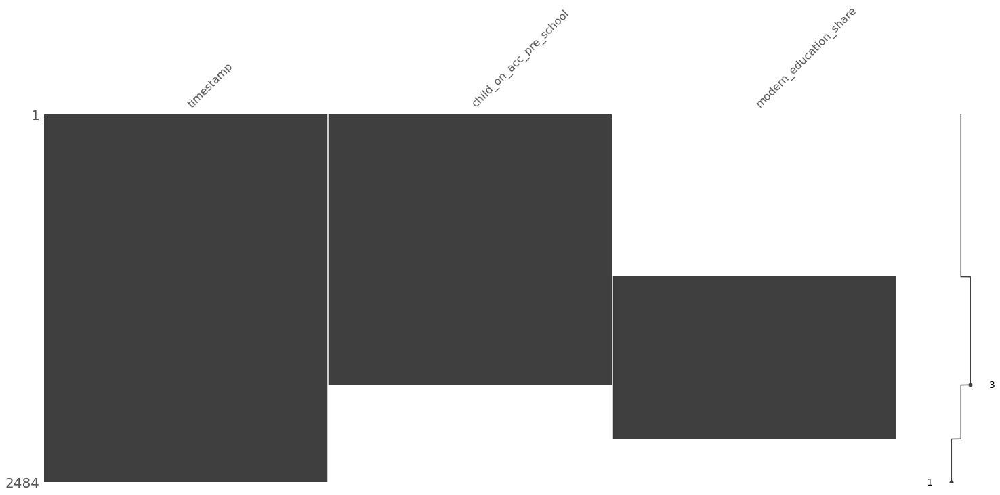

In [6]:
msno.matrix(df.loc[:,['timestamp','child_on_acc_pre_school','modern_education_share']]) 
#msno.matrix(df.loc[:,['timestamp','child_on_acc_pre_school']]) 

In [13]:
# Actividad: Eliminar todas las columnas de datos que presenten un porcentaje de datos perdidos sobre un 20% del total de la muestra.

perdidos = 0

for col in df.columns:
    pct_missing = np.mean(df[col].isnull())

    if pct_missing > 0.2:
        perdidos += 1
        df = df.drop(col, axis=1)
    #print('{} - {}%'.format(col, round(pct_missing*100)))

print(perdidos)
df.head()




0


,timestamp,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,...,rent_price_2room_bus,rent_price_1room_bus,rent_price_3room_eco,rent_price_2room_eco,rent_price_1room_eco,load_of_teachers_school_per_teacher,provision_nurse,load_on_doctors,turnover_catering_per_cap,seats_theather_rfmin_per_100000_cap
0,2010-01-01,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1356.112607,99.4,7872.848285,6221.0,0.41
1,2010-01-02,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1356.112607,99.4,7872.848285,6221.0,0.41
2,2010-01-03,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1356.112607,99.4,7872.848285,6221.0,0.41
3,2010-01-04,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.905,...,NaN,NaN,NaN,NaN,NaN,1356.112607,99.4,7872.848285,6221.0,0.41
4,2010-01-05,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.836,...,NaN,NaN,NaN,NaN,NaN,1356.112607,99.4,7872.848285,6221.0,0.41


<AxesSubplot:>

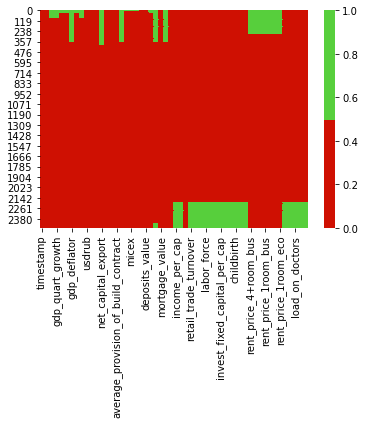

In [14]:
#cols = df.columns[:45] 
cols = df.columns[:45] 
colours = ['#cf1002','#57cf3c'] 
sns.heatmap(df[cols].isnull(), cmap=sns.color_palette(colours)) 

#burdeo: #cf1002 #verde: #57cf3c 

<AxesSubplot:>

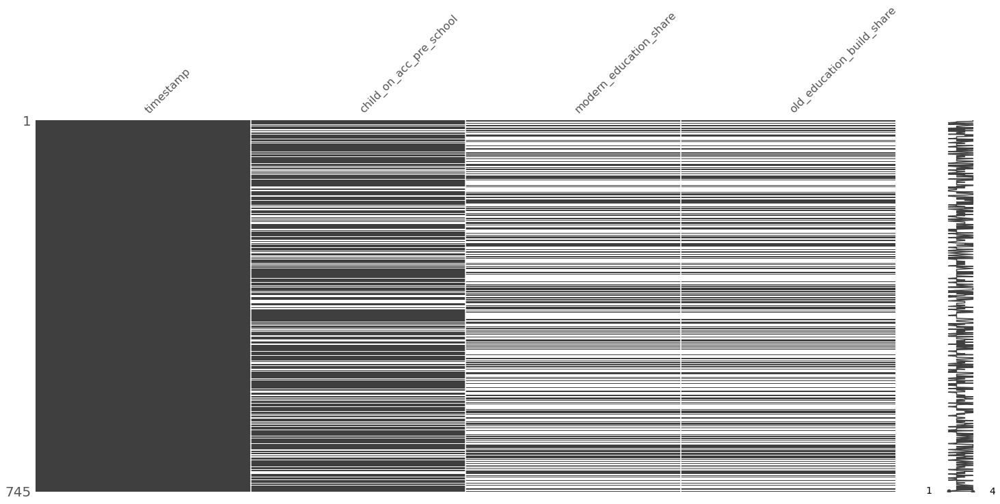

In [7]:
msno.matrix(df.loc[:,['timestamp', 'child_on_acc_pre_school', 'modern_education_share','old_education_build_share']].sample(frac=0.3))